In [1]:
import pandas as pd
import numpy as np
from pandas_profiling import ProfileReport

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
df = pd.read_csv("emp_data_decesion_tree.csv")

In [4]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


In [5]:
pd_profile = ProfileReport(df, title="Employee data frame profile report", explorative=True)

In [6]:
pd_profile

Summarize dataset:   0%|          | 0/48 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [7]:
df.isna().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

In [8]:
attr_numeric = {'Yes':1, 'No':0}
df['Attrition_Num'] = df['Attrition'].apply(lambda x: attr_numeric[x])
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition_Num
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,80,0,8,0,1,6,4,0,5,1
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,80,1,10,3,3,10,7,1,7,0
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,80,0,7,3,3,0,0,0,0,1
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,80,0,8,3,3,8,7,3,0,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,80,1,6,3,3,2,2,2,2,0


In [9]:
df.columns

Index(['Age', 'Attrition', 'BusinessTravel', 'DailyRate', 'Department',
       'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction',
       'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating',
       'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager', 'Attrition_Num'],
      dtype='object')

In [10]:
cat_value = df[['BusinessTravel', 'Department', 'EducationField', 'Gender', 'JobRole', 'MaritalStatus', 'Over18', 'OverTime']]

In [11]:
cat_value.head()

,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,Over18,OverTime
0,Travel_Rarely,Sales,Life Sciences,Female,Sales Executive,Single,Y,Yes
1,Travel_Frequently,Research & Development,Life Sciences,Male,Research Scientist,Married,Y,No
2,Travel_Rarely,Research & Development,Other,Male,Laboratory Technician,Single,Y,Yes
3,Travel_Frequently,Research & Development,Life Sciences,Female,Research Scientist,Married,Y,Yes
4,Travel_Rarely,Research & Development,Medical,Male,Laboratory Technician,Married,Y,No


In [12]:
cat_val_dummy = pd.get_dummies(cat_value)

In [13]:
cat_val_dummy.head()

,BusinessTravel_Non-Travel,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,Department_Human Resources,Department_Research & Development,Department_Sales,EducationField_Human Resources,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,...,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Over18_Y,OverTime_No,OverTime_Yes
0,0,0,1,0,0,1,0,1,0,0,...,0,0,1,0,0,0,1,1,0,1
1,0,1,0,0,1,0,0,1,0,0,...,0,1,0,0,0,1,0,1,1,0
2,0,0,1,0,1,0,0,0,0,0,...,0,0,0,0,0,0,1,1,0,1
3,0,1,0,0,1,0,0,1,0,0,...,0,1,0,0,0,1,0,1,0,1
4,0,0,1,0,1,0,0,0,0,1,...,0,0,0,0,0,1,0,1,1,0


In [14]:
df_num_data = df.drop(['Attrition', 'BusinessTravel', 'Department', 'EducationField', 'Gender', 'JobRole', 'MaritalStatus', 'Over18', 'OverTime'], axis=1)

In [15]:
df_num_data.head()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition_Num
0,41,1102,1,2,1,1,2,94,3,2,...,80,0,8,0,1,6,4,0,5,1
1,49,279,8,1,1,2,3,61,2,2,...,80,1,10,3,3,10,7,1,7,0
2,37,1373,2,2,1,4,4,92,2,1,...,80,0,7,3,3,0,0,0,0,1
3,33,1392,3,4,1,5,4,56,3,1,...,80,0,8,3,3,8,7,3,0,0
4,27,591,2,1,1,7,1,40,3,1,...,80,1,6,3,3,2,2,2,2,0


In [16]:
df_final = pd.concat((df_num_data, cat_val_dummy), axis=1)

In [17]:
df_final.head()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Over18_Y,OverTime_No,OverTime_Yes
0,41,1102,1,2,1,1,2,94,3,2,...,0,0,1,0,0,0,1,1,0,1
1,49,279,8,1,1,2,3,61,2,2,...,0,1,0,0,0,1,0,1,1,0
2,37,1373,2,2,1,4,4,92,2,1,...,0,0,0,0,0,0,1,1,0,1
3,33,1392,3,4,1,5,4,56,3,1,...,0,1,0,0,0,1,0,1,0,1
4,27,591,2,1,1,7,1,40,3,1,...,0,0,0,0,0,1,0,1,1,0


In [18]:
X = df_final.drop('Attrition_Num', axis=1)
y = df['Attrition_Num']

In [19]:
X.head()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Over18_Y,OverTime_No,OverTime_Yes
0,41,1102,1,2,1,1,2,94,3,2,...,0,0,1,0,0,0,1,1,0,1
1,49,279,8,1,1,2,3,61,2,2,...,0,1,0,0,0,1,0,1,1,0
2,37,1373,2,2,1,4,4,92,2,1,...,0,0,0,0,0,0,1,1,0,1
3,33,1392,3,4,1,5,4,56,3,1,...,0,1,0,0,0,1,0,1,0,1
4,27,591,2,1,1,7,1,40,3,1,...,0,0,0,0,0,1,0,1,1,0


In [20]:
y.head()

0    1
1    0
2    1
3    0
4    0
Name: Attrition_Num, dtype: int64

In [21]:
from sklearn.model_selection import train_test_split

In [22]:
X_train, x_test, Y_train, y_test = train_test_split(X, y, train_size=0.80, random_state=0)

In [23]:
Y_train.head()

1374    0
1092    0
768     0
569     0
911     1
Name: Attrition_Num, dtype: int64

In [24]:
from sklearn.tree import DecisionTreeClassifier

In [25]:
e_cls = DecisionTreeClassifier()

In [26]:
e_cls.fit(X_train, Y_train)

DecisionTreeClassifier()

In [27]:
e_cls.score(x_test, y_test)

0.7653061224489796

In [28]:
import graphviz
from sklearn.tree import export_graphviz
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, confusion_matrix, roc_auc_score, roc_curve
from six import StringIO
from IPython.display import Image
import pydotplus

In [29]:
feature_name = list(X.columns)
class_name= list(y.unique())
feature_name, class_name

(['Age',
  'DailyRate',
  'DistanceFromHome',
  'Education',
  'EmployeeCount',
  'EmployeeNumber',
  'EnvironmentSatisfaction',
  'HourlyRate',
  'JobInvolvement',
  'JobLevel',
  'JobSatisfaction',
  'MonthlyIncome',
  'MonthlyRate',
  'NumCompaniesWorked',
  'PercentSalaryHike',
  'PerformanceRating',
  'RelationshipSatisfaction',
  'StandardHours',
  'StockOptionLevel',
  'TotalWorkingYears',
  'TrainingTimesLastYear',
  'WorkLifeBalance',
  'YearsAtCompany',
  'YearsInCurrentRole',
  'YearsSinceLastPromotion',
  'YearsWithCurrManager',
  'BusinessTravel_Non-Travel',
  'BusinessTravel_Travel_Frequently',
  'BusinessTravel_Travel_Rarely',
  'Department_Human Resources',
  'Department_Research & Development',
  'Department_Sales',
  'EducationField_Human Resources',
  'EducationField_Life Sciences',
  'EducationField_Marketing',
  'EducationField_Medical',
  'EducationField_Other',
  'EducationField_Technical Degree',
  'Gender_Female',
  'Gender_Male',
  'JobRole_Healthcare Represen

In [30]:
try:
    dot_data = export_graphviz(e_cls, feature_names=feature_name, rounded=True, filled=True)
    graph = pydotplus.graph_from_dot_data(dot_data)
    graph.write_png('emp_tree.png')
    Image(graph.create_png())
except Exception as e:
    print(e)

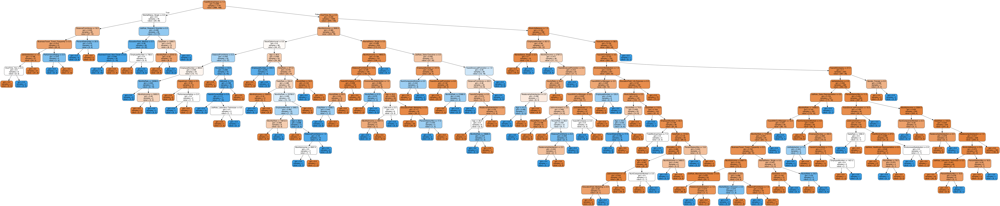

In [31]:
Image('emp_tree.png')

In [32]:
import pickle
file_name = "emp_attrition.pickle"
pickle.dump(e_cls, open(file_name, 'wb'))

In [33]:
model = pickle.load(open('emp_attrition.pickle', 'rb'))

In [36]:
x_test.iloc[0]

Age                                     36
DailyRate                              635
DistanceFromHome                        10
Education                                4
EmployeeCount                            1
EmployeeNumber                         592
EnvironmentSatisfaction                  2
HourlyRate                              32
JobInvolvement                           3
JobLevel                                 3
JobSatisfaction                          4
MonthlyIncome                         9980
MonthlyRate                          15318
NumCompaniesWorked                       1
PercentSalaryHike                       14
PerformanceRating                        3
RelationshipSatisfaction                 4
StandardHours                           80
StockOptionLevel                         0
TotalWorkingYears                       10
TrainingTimesLastYear                    3
WorkLifeBalance                          2
YearsAtCompany                          10
YearsInCurr

In [39]:
#model.predict([[]])

In [40]:
scaler = StandardScaler()

In [41]:
x_transform = scaler.fit_transform(X)

In [42]:
x_train, x_test, y_train, y_test = train_test_split(x_transform, y, test_size=0.30, random_state=355)

In [43]:
from sklearn.decomposition import PCA

pca = PCA()

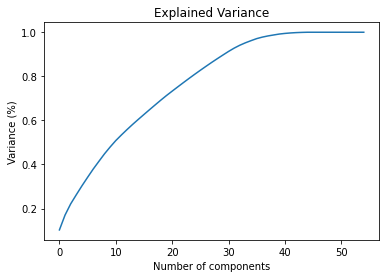

In [45]:
principleComponents = pca.fit_transform(x_transform)
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of components')
plt.ylabel('Variance (%)')
plt.title('Explained Variance')
plt.show()

In [46]:
pca = PCA(n_components=55)

In [47]:
new_data = pca.fit_transform(x_transform)

In [51]:
principal_x = pd.DataFrame(new_data, columns=["PC-"+str(i) for i in range(1, 56)])
principal_x

,PC-1,PC-2,PC-3,PC-4,PC-5,PC-6,PC-7,PC-8,PC-9,PC-10,...,PC-46,PC-47,PC-48,PC-49,PC-50,PC-51,PC-52,PC-53,PC-54,PC-55
0,-0.020877,2.265147,-1.308211,3.292186,-0.141963,-0.297647,-1.025187,-0.277470,-0.510499,-2.015312,...,1.089736e-14,1.702394e-15,7.187020e-16,-9.183602e-16,-3.612394e-17,-2.054345e-16,1.191133e-15,-3.740626e-16,2.370971e-16,-2.241217e-16
1,0.062323,-1.576007,-0.306943,-1.555598,0.819700,2.224209,0.990184,1.154371,2.475593,-1.232759,...,-2.590862e-15,8.043879e-16,7.333050e-16,-2.078581e-16,5.143977e-16,3.396815e-16,-5.621459e-17,3.126175e-16,-1.680950e-16,-1.096956e-16
2,-2.915955,-1.030794,-0.356093,1.683154,-0.070083,-0.102972,-2.854050,-0.840222,0.563966,0.625816,...,-3.030306e-15,-8.153529e-17,9.231566e-17,-2.528463e-17,-4.503790e-16,2.901624e-16,-2.963965e-16,-7.784242e-17,-1.618165e-16,1.503656e-16
3,-1.182328,-1.087294,-0.838574,2.350113,-0.240637,2.527638,0.897620,0.029128,-1.755893,-1.845730,...,1.900621e-15,1.111639e-15,-3.013588e-16,-5.413079e-16,4.218956e-17,6.296344e-16,-4.614175e-17,-1.994028e-16,-1.448993e-17,-7.387617e-17
4,-2.109580,-1.223409,0.432590,-1.198194,-0.628299,-1.653883,-0.575456,-0.284517,-0.529903,1.768665,...,6.638250e-15,6.451207e-15,-5.445258e-15,4.563499e-15,-3.715039e-16,1.879349e-15,2.402389e-16,6.781095e-16,9.933932e-16,-1.030606e-15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,-1.124604,-1.337438,0.352797,-1.761081,-0.290785,0.743323,0.042356,1.529985,-0.350412,1.343600,...,-2.679465e-16,1.477159e-16,-1.446463e-16,-1.134505e-16,-1.387027e-16,7.090540e-17,5.248853e-17,6.833969e-17,-1.585074e-16,3.384372e-17
1466,0.910748,-1.405481,0.269853,-1.429635,-0.480651,-1.105006,0.071946,-0.782042,0.027350,1.683086,...,3.820498e-16,-1.036944e-16,-5.523590e-18,-1.977449e-17,-8.811325e-18,7.354795e-17,-5.352961e-17,7.813270e-17,-1.338728e-16,1.067588e-17
1467,-1.086119,-1.215895,0.230193,0.370657,-1.702591,1.170231,-0.281836,-0.977276,3.014319,-2.021611,...,1.954550e-16,-3.053201e-17,-5.102260e-17,2.116750e-17,4.397191e-17,1.552985e-17,-2.927930e-17,-1.202098e-17,-1.010267e-16,-2.129353e-17
1468,1.174685,2.027912,-0.111596,-1.512264,0.446117,0.955944,-0.222865,0.935329,-0.765848,1.055708,...,-1.371492e-15,1.453603e-16,8.928908e-17,1.174582e-17,4.303569e-17,5.611125e-17,5.149471e-17,3.677894e-18,1.825886e-17,-6.048401e-17


In [52]:
x_train, x_test, y_train, y_test = train_test_split(principal_x, y, test_size=0.30, random_state=355)
e_clf = DecisionTreeClassifier()
e_clf.fit(x_train, y_train)

DecisionTreeClassifier()

In [53]:
e_clf.score(x_test, y_test)

0.7732426303854876

In [80]:
depth = np.arange(1,100)
leaves = [1,2,4,5,10,20,30,40,80,100]
grid_search_parameter = {
    'criterion': ['gini', 'entropy'],
    'max_depth':depth,
    'min_samples_leaf':leaves,
    'splitter': ['best', 'random']
}

In [81]:
grid_search_cv = GridSearchCV(estimator=e_clf, param_grid=grid_search_parameter, cv=10, n_jobs=-1)

In [82]:
grid_search_cv.fit(x_train, y_train)

GridSearchCV(cv=10, estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51,
       52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68,
       69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85,
       86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99]),
                         'min_samples_leaf': [1, 2, 4, 5, 10, 20, 30, 40, 80,
                                              100],
                         'splitter': ['best', 'random']})

In [83]:
grid_search_cv.best_score_

0.8551970302684181

In [84]:
grid_search_cv.best_params_

{'criterion': 'entropy',
 'max_depth': 24,
 'min_samples_leaf': 20,
 'splitter': 'random'}

In [85]:
e_clf = DecisionTreeClassifier(criterion='entropy', max_depth=24, min_samples_leaf=20, splitter='random')
e_clf.fit(x_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=24, min_samples_leaf=20,
                       splitter='random')

In [88]:
e_clf.score(x_train, y_train)

0.8522837706511176

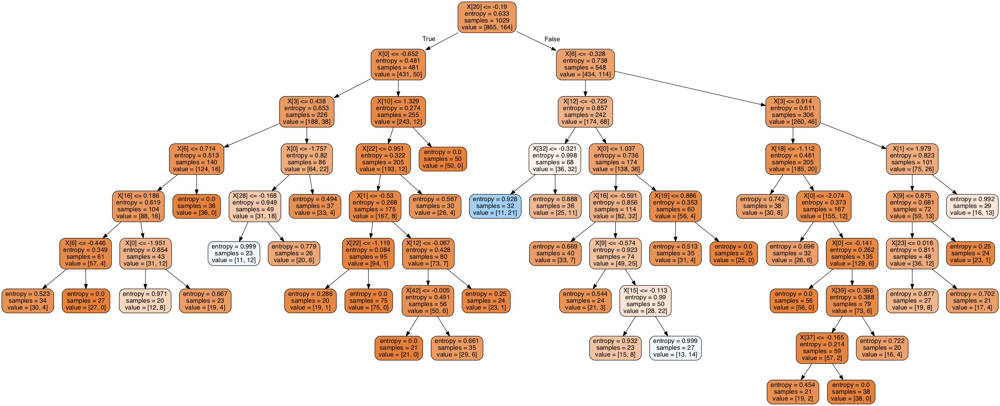

In [90]:
feature_name=list(X.columns)
class_name = list(y_train.unique())

dot_data = export_graphviz(e_clf, rounded=True, filled=True)

graph = pydotplus.graph_from_dot_data(dot_data)
graph.write_png('emp_clf.png')
Image(graph.create_png())

In [91]:
file_name = "emp_attr.pickle"
pickle.dump(e_clf, open(file_name, 'wb'))

In [92]:
file_name = "emp_attr_pca.pickle"
pickle.dump(pca, open(file_name, 'wb'))

In [93]:
file_name = "emp_attr_sdtscal.pickle"
pickle.dump(scaler, open(file_name, 'wb'))